# Exercise IV - Explore the Use of API & Image Analysis (Week 2 & Week 8) 

This exercise focuses on exploring the use of API for different purposes, including retrieving information, creating datasets and fun applications, etc.

The data (both text and image) retrieved were used in building a simple web program and to explore image clustering task based on the content covered in Week 8 on Unsupervised Learning.

The following APIs were used in this exercise: 
1)	The Nobel Prize API (https://www.nobelprize.org/about/developer-zone-2/) 
2)	OpenWeather API (https://openweathermap.org/api) 
3)	The Cat API (https://thecatapi.com/) 
4)	Unsplash API (https://unsplash.com/developers)

## Getting Data from APIs

Here is the attempt to retrieve different kinds of data (text, image) using APIs.

In [8]:
import requests
import pandas as pd
import os  
import re
# import time
# import urllib.request
# from urllib.request import urlopen
# from urllib.error import URLError, HTTPError
import matplotlib.pyplot as plt
from IPython.display import Image, display

### Getting Text Data from The Nobel Prize API

[The Nobel Prize API](https://www.nobelprize.org/about/developer-zone-2/) is explored here to obtain some information about the Nobel Prizes and the Nobel Laureates.

The API & services are free to use according to the Creative Commons Zero (CC0) license. [Term of Use](https://www.nobelprize.org/about/terms-of-use-for-api-nobelprize-org-and-data-nobelprize-org/); [API Documentation](https://app.swaggerhub.com/apis/NobelMedia/NobelMasterData/2.0)

2 endpoints are available for use:

- https://api.nobelprize.org/2.1/laureates; returns all information about Laureates and Nobel Prizes.
- https://api.nobelprize.org/2.1/nobelPrizes; returns a shorter result and the Laureates endpoint needs to be called as well to get the full response.

*the first awarded prize: 10 December 1901; 122 years ago

All the information can also be obtained using the search services through the website's [linked data](https://data.nobelprize.org/?_ga=2.184532134.1012915448.1534348310-193862564.1534234067)

Reflection - Overall, APIs can be very useful in retrieving large amounts of text data and creating datasets. Nevertheless, while this is very effective in terms of data collection, the data we retrieve can still be unformatted (e.g., one column contains multiple features) or contain errors and missing data. The data will also carry biases which can be even harder for us to spot as we did not go through the initial data collection. So, it is important to go through the original documentation of the API and even check the sources whenever possible, to make sure that we understand the data and can pre-process them accordingly before doing analysis.

#### Obtaining specific data

Let's see if we can find out who won the chemistry nobel prizes last year... 

p.s. use https://jsonviewer.stack.hu/ to transform JSON text into (easy) readable format

In [2]:
endpoint = 'http://api.nobelprize.org/2.0/nobelPrize/'
category = 'che' # che, eco, lit, pea, phy, med
year = '2023' # choose from 1901 to 2023

url = endpoint + category + "/" + year
response = requests.get(url)
response.status_code

200

In [3]:
response.text

'[{"awardYear":"2023","category":{"en":"Chemistry","no":"Kjemi","se":"Kemi"},"categoryFullName":{"en":"The Nobel Prize in Chemistry","no":"Nobelprisen i kjemi","se":"Nobelpriset i kemi"},"dateAwarded":"2023-10-04","prizeAmount":11000000,"prizeAmountAdjusted":11000000,"links":{"rel":"nobelPrize","href":"https:\\/\\/api.nobelprize.org\\/2\\/nobelPrize\\/che\\/2023","action":"Get","types":"application\\/json"},"laureates":[{"id":"1029","knownName":{"en":"Moungi Bawendi"},"fullName":{"en":"Moungi G. Bawendi"},"portion":"1\\/3","sortOrder":"1","motivation":{"en":"for the discovery and synthesis of quantum dots","se":"f\\u00f6r uppt\\u00e4ckt och syntes av kvantprickar"},"links":{"rel":"laureate","href":"https:\\/\\/api.nobelprize.org\\/2\\/laureate\\/1029","action":"Get","types":"application\\/json"}},{"id":"1030","knownName":{"en":"Louis Brus"},"fullName":{"en":"Louis E. Brus"},"portion":"1\\/3","sortOrder":"2","motivation":{"en":"for the discovery and synthesis of quantum dots","se":"f\\u

In [4]:
results = response.json()
name_list = [laureate['fullName']['en'] for laureate in results[0]['laureates']]
print(f"There are {len(results[0]['laureates'])} nobel prizes winner in {results[0]['awardYear']} in {results[0]['category']['en']}: {name_list}")

There are 3 nobel prizes winner in 2023 in Chemistry: ['Moungi G. Bawendi', 'Louis E. Brus', 'Aleksey Yekimov ']


#### Obtaining/Creating a full dataset - nobel-prizes-1901-2023 dataset

Explore the use of obtaining a full dataset

In [5]:
# default endpoint setting only returns 25 entries - add a limit of 1000 to show all resutls
prizes_url = 'http://api.nobelprize.org/2.0/nobelPrizes?limit=1000'
prizes_response = requests.get(prizes_url)
prizes_response.status_code

KeyboardInterrupt: 

In [ ]:
prizes_response.text

'{"nobelPrizes":[{"awardYear":"1901","category":{"en":"Chemistry","no":"Kjemi","se":"Kemi"},"categoryFullName":{"en":"The Nobel Prize in Chemistry","no":"Nobelprisen i kjemi","se":"Nobelpriset i kemi"},"dateAwarded":"1901-11-12","prizeAmount":150782,"prizeAmountAdjusted":9704878,"links":{"rel":"nobelPrize","href":"https:\\/\\/api.nobelprize.org\\/2\\/nobelPrize\\/che\\/1901","action":"Get","types":"application\\/json"},"laureates":[{"id":"160","knownName":{"en":"Jacobus H. van \'t Hoff"},"fullName":{"en":"Jacobus Henricus van \'t Hoff"},"portion":"1","sortOrder":"1","motivation":{"en":"in recognition of the extraordinary services he has rendered by the discovery of the laws of chemical dynamics and osmotic pressure in solutions","se":"s\\u00e5som ett erk\\u00e4nnande av den utomordentliga f\\u00f6rtj\\u00e4nst han inlagt genom uppt\\u00e4ckten av lagarna f\\u00f6r den kemiska dynamiken och f\\u00f6r det osmotiska trycket i l\\u00f6sningar"},"links":{"rel":"laureate","href":"https:\\/\\

In [ ]:
prizes_results = prizes_response.json()
prizes_results

{'nobelPrizes': [{'awardYear': '1901',
   'category': {'en': 'Chemistry', 'no': 'Kjemi', 'se': 'Kemi'},
   'categoryFullName': {'en': 'The Nobel Prize in Chemistry',
    'no': 'Nobelprisen i kjemi',
    'se': 'Nobelpriset i kemi'},
   'dateAwarded': '1901-11-12',
   'prizeAmount': 150782,
   'prizeAmountAdjusted': 9704878,
   'links': {'rel': 'nobelPrize',
    'href': 'https://api.nobelprize.org/2/nobelPrize/che/1901',
    'action': 'Get',
    'types': 'application/json'},
   'laureates': [{'id': '160',
     'knownName': {'en': "Jacobus H. van 't Hoff"},
     'fullName': {'en': "Jacobus Henricus van 't Hoff"},
     'portion': '1',
     'sortOrder': '1',
     'motivation': {'en': 'in recognition of the extraordinary services he has rendered by the discovery of the laws of chemical dynamics and osmotic pressure in solutions',
      'se': 'såsom ett erkännande av den utomordentliga förtjänst han inlagt genom upptäckten av lagarna för den kemiska dynamiken och för det osmotiska trycket i l

In [ ]:
prizes_results.keys()

dict_keys(['nobelPrizes', 'meta', 'links'])

In [ ]:
nobelprizes = prizes_results['nobelPrizes'] 

# put data into a df and only keep columns needed
prizes_df = pd.json_normalize(nobelprizes)
prizes_df = prizes_df[['awardYear', 'dateAwarded', 'laureates', 'prizeAmountAdjusted', 'category.en', 'links.href']]
prizes_df

,awardYear,dateAwarded,laureates,prizeAmountAdjusted,category.en,links.href
0,1901,1901-11-12,"[{'id': '160', 'knownName': {'en': 'Jacobus H....",9704878,Chemistry,https://api.nobelprize.org/2/nobelPrize/che/1901
1,1901,1901-11-14,"[{'id': '569', 'knownName': {'en': 'Sully Prud...",9704878,Literature,https://api.nobelprize.org/2/nobelPrize/lit/1901
2,1901,1901-12-10,"[{'id': '462', 'knownName': {'en': 'Henry Duna...",9704878,Peace,https://api.nobelprize.org/2/nobelPrize/pea/1901
3,1901,1901-11-12,"[{'id': '1', 'knownName': {'en': 'Wilhelm Conr...",9704878,Physics,https://api.nobelprize.org/2/nobelPrize/phy/1901
4,1901,1901-10-30,"[{'id': '293', 'knownName': {'en': 'Emil von B...",9704878,Physiology or Medicine,https://api.nobelprize.org/2/nobelPrize/med/1901
...,...,...,...,...,...,...
665,2023,2023-10-09,"[{'id': '1034', 'knownName': {'en': 'Claudia G...",11000000,Economic Sciences,https://api.nobelprize.org/2/nobelPrize/eco/2023
666,2023,2023-10-05,"[{'id': '1032', 'knownName': {'en': 'Jon Fosse...",11000000,Literature,https://api.nobelprize.org/2/nobelPrize/lit/2023
667,2023,2023-10-06,"[{'id': '1033', 'knownName': {'en': 'Narges Mo...",11000000,Peace,https://api.nobelprize.org/2/nobelPrize/pea/2023
668,2023,2023-10-03,"[{'id': '1026', 'knownName': {'en': 'Pierre Ag...",11000000,Physics,https://api.nobelprize.org/2/nobelPrize/phy/2023


In [ ]:
# any missing data
prizes_df.isnull().sum()

awardYear               0
dateAwarded            47
laureates              49
prizeAmountAdjusted     0
category.en             0
links.href              0
dtype: int64

In [ ]:
# to check what are those missing laureates
missing_laureates = prizes_df[prizes_df['laureates'].isnull()]

# iterate through the df and use the link retrieved to extract motivation
for index, row in missing_laureates.iterrows():
    link = row['links.href']  
    response = requests.get(link)
    if response.status_code == 200:
        data = response.json()
        if data and 'topMotivation' in data[0]:
            print(data[0]['topMotivation']['en'])
        else:
            print("no motivation info")
    else:
        print("there is some error")

No Nobel Prize was awarded this year. The prize money was allocated to the Special Fund of this prize section.
No Nobel Prize was awarded this year. The prize money was allocated to the Special Fund of this prize section.
No Nobel Prize was awarded this year. The prize money was allocated to the Special Fund of this prize section.
No Nobel Prize was awarded this year. The prize money was allocated to the Special Fund of this prize section.
No Nobel Prize was awarded this year. The prize money was allocated to the Special Fund of this prize section.
No Nobel Prize was awarded this year. The prize money was allocated to the Special Fund of this prize section.
No Nobel Prize was awarded this year. The prize money was allocated to the Special Fund of this prize section.
No Nobel Prize was awarded this year. The prize money was allocated to the Special Fund of this prize section.
No Nobel Prize was awarded this year. The prize money was allocated to the Special Fund of this prize section.
N

Based on the above results, all rows with missing lauretaes are the years with no nobel prize awarded - which can be safely removed from the df!

In [ ]:
prizes_df = prizes_df.dropna(subset=['laureates'])
prizes_df

,awardYear,dateAwarded,laureates,prizeAmountAdjusted,category.en,links.href
0,1901,1901-11-12,"[{'id': '160', 'knownName': {'en': 'Jacobus H....",9704878,Chemistry,https://api.nobelprize.org/2/nobelPrize/che/1901
1,1901,1901-11-14,"[{'id': '569', 'knownName': {'en': 'Sully Prud...",9704878,Literature,https://api.nobelprize.org/2/nobelPrize/lit/1901
2,1901,1901-12-10,"[{'id': '462', 'knownName': {'en': 'Henry Duna...",9704878,Peace,https://api.nobelprize.org/2/nobelPrize/pea/1901
3,1901,1901-11-12,"[{'id': '1', 'knownName': {'en': 'Wilhelm Conr...",9704878,Physics,https://api.nobelprize.org/2/nobelPrize/phy/1901
4,1901,1901-10-30,"[{'id': '293', 'knownName': {'en': 'Emil von B...",9704878,Physiology or Medicine,https://api.nobelprize.org/2/nobelPrize/med/1901
...,...,...,...,...,...,...
665,2023,2023-10-09,"[{'id': '1034', 'knownName': {'en': 'Claudia G...",11000000,Economic Sciences,https://api.nobelprize.org/2/nobelPrize/eco/2023
666,2023,2023-10-05,"[{'id': '1032', 'knownName': {'en': 'Jon Fosse...",11000000,Literature,https://api.nobelprize.org/2/nobelPrize/lit/2023
667,2023,2023-10-06,"[{'id': '1033', 'knownName': {'en': 'Narges Mo...",11000000,Peace,https://api.nobelprize.org/2/nobelPrize/pea/2023
668,2023,2023-10-03,"[{'id': '1026', 'knownName': {'en': 'Pierre Ag...",11000000,Physics,https://api.nobelprize.org/2/nobelPrize/phy/2023


According to the [nobelprize.org](https://www.nobelprize.org/prizes/lists/all-nobel-prizes/#:~:text=All%20Nobel%20Prizes-,All%20Nobel%20Prizes,to%201%2C000%20people%20and%20organisations.), ... "between 1901 and 2023, the Nobel Prizes and the Sveriges Riksbank Prize in Economic Sciences in Memory of Alfred Nobel were awarded 621 times to 1,000 people and organisations..." 621 times matches the 621 rows, meaning that we have sucuessfully extract all award information between 1901 to 2023

However, one entry could obtain two or more laureates, which is a bit complicated to extract and form up a new df, let's try another endpoint to see if it's easier to obtain a clean dataset.

In [ ]:
# default endpoint setting only returns 25 entries - add a limit of 1000 to show all resutls
laureates_url = 'http://api.nobelprize.org/2.0/laureates?limit=1000'
laureates_response = requests.get(laureates_url)
laureates_response.status_code

200

In [ ]:
laureates_results = laureates_response.json()
laureates_results

{'laureates': [{'id': '745',
   'knownName': {'en': 'A. Michael Spence', 'se': 'A. Michael Spence'},
   'givenName': {'en': 'A. Michael', 'se': 'A. Michael'},
   'familyName': {'en': 'Spence', 'se': 'Spence'},
   'fullName': {'en': 'A. Michael Spence', 'se': 'A. Michael Spence'},
   'fileName': 'spence',
   'gender': 'male',
   'birth': {'date': '1943-00-00',
    'place': {'city': {'en': 'Montclair, NJ',
      'no': 'Montclair, NJ',
      'se': 'Montclair, NJ'},
     'country': {'en': 'USA', 'no': 'USA', 'se': 'USA'},
     'cityNow': {'en': 'Montclair, NJ',
      'no': 'Montclair, NJ',
      'se': 'Montclair, NJ',
      'sameas': ['https://www.wikidata.org/wiki/Q678437',
       'https://www.wikipedia.org/wiki/Montclair,_New_Jersey']},
     'countryNow': {'en': 'USA',
      'no': 'USA',
      'se': 'USA',
      'sameas': ['https://www.wikidata.org/wiki/Q30']},
     'continent': {'en': 'North America',
      'no': 'Nord-Amerika',
      'se': 'Nordamerika'},
     'locationString': {'en': 

In [ ]:
laureates = laureates_results['laureates'] 

# put data into a dataframe
laureates_df = pd.json_normalize(laureates)

# iterate through the list and using link provided to extract other info
# reference code found in: https://www.geeksforgeeks.org/python-pandas-dataframe-at/
# data.at[position, label], return data at the passed location
for index, row in laureates_df.iterrows():
    laureates_df.at[index, 'awardYear'] = row['nobelPrizes'][0]['awardYear']
    laureates_df.at[index, 'category'] = row['nobelPrizes'][0]['category']['en']
    laureates_df.at[index, 'motivation'] = row['nobelPrizes'][0]['motivation']['en']
    laureates_df.at[index, 'prizeAmountAdjusted'] = row['nobelPrizes'][0]['prizeAmountAdjusted']

# convert data types
laureates_df['awardYear'] = pd.to_numeric(laureates_df['awardYear'])
laureates_df['prizeAmountAdjusted'] = pd.to_numeric(laureates_df['prizeAmountAdjusted'])

# only keep columns we want and re-order
laureates_df = laureates_df[['awardYear', 'category', 'knownName.en', 'motivation', 'prizeAmountAdjusted', 'wikipedia.english', 'links.href']]
laureates_df = laureates_df.sort_values(by='awardYear', ascending=False)

laureates_df

,awardYear,category,knownName.en,motivation,prizeAmountAdjusted,wikipedia.english,links.href
33,2023,Chemistry,Aleksey Yekimov,for the discovery and synthesis of quantum dots,11000000.0,https://en.wikipedia.org/wiki/Alexei_Ekimov,https://api.nobelprize.org/2/laureate/1031
537,2023,Physiology or Medicine,Katalin Karikó,for their discoveries concerning nucleoside ba...,11000000.0,https://en.wikipedia.org/wiki/Katalin_Karikó,https://api.nobelprize.org/2/laureate/1024
647,2023,Chemistry,Moungi Bawendi,for the discovery and synthesis of quantum dots,11000000.0,https://en.wikipedia.org/wiki/Moungi_Bawendi,https://api.nobelprize.org/2/laureate/1029
655,2023,Peace,Narges Mohammadi,for her fight against the oppression of women ...,11000000.0,https://en.wikipedia.org/wiki/Narges_Mohammadi,https://api.nobelprize.org/2/laureate/1033
583,2023,Chemistry,Louis Brus,for the discovery and synthesis of quantum dots,11000000.0,https://en.wikipedia.org/wiki/Louis_E._Brus,https://api.nobelprize.org/2/laureate/1030
...,...,...,...,...,...,...,...
882,1901,Literature,Sully Prudhomme,in special recognition of his poetic compositi...,9704878.0,https://en.wikipedia.org/wiki/Sully_Prudhomme,https://api.nobelprize.org/2/laureate/569
283,1901,Peace,Frédéric Passy,for his lifelong work for international peace ...,9704878.0,https://en.wikipedia.org/wiki/Frédéric_Passy,https://api.nobelprize.org/2/laureate/463
441,1901,Chemistry,Jacobus H. van 't Hoff,in recognition of the extraordinary services h...,9704878.0,https://en.wikipedia.org/wiki/Jacobus_Henricus...,https://api.nobelprize.org/2/laureate/160
949,1901,Physics,Wilhelm Conrad Röntgen,in recognition of the extraordinary services h...,9704878.0,https://en.wikipedia.org/wiki/Wilhelm_Röntgen,https://api.nobelprize.org/2/laureate/1


According to the [nobelprize.org](https://www.nobelprize.org/prizes/lists/all-nobel-prizes/#:~:text=All%20Nobel%20Prizes-,All%20Nobel%20Prizes,to%201%2C000%20people%20and%20organisations.) again, "...with some receiving the Nobel Prize more than once, this makes a total of 965 individuals and 27 organisations.s..." 992 times matches the 992 rows, meaning that using a different endpoint, we have also sucuessfully extract all award information between 1901 to 2023.

df is then converted to csv which can be using for other data analysis tasks.

In [ ]:
# convert to csv file - can be used for other tasks
laureates_df.to_csv('./data/nobel-prizes-1901-2023.csv')

### Getting Weather Data from OpenWeather API

Instead of obtaining data / creating a dataset for analysis, API can also be used for getting weather data.

[The OpenWeather API](https://openweathermap.org/api) offers some free services that can be used to obtain current and forecast weather data: [current weather data](https://openweathermap.org/current) / [5 day / 3 hour forecast data](https://openweathermap.org/forecast5#limit).

#### Current Weather

Using the current weather API to obtain current weather information in a specific location (lat, lon) - here I googled the lat and lon of London.

  - lat = 51.507351
  - lon = -0.127758

OpenWeather API needs apikey to authenticate - which can be obtained quite easily and it's also free

In [ ]:
# London, can be changed to other location using different lat&lon
lat = 51.507351
lon = -0.127758

# apikey obtained from openweather api
api_key = '93146e366d37fc681f5daf1f33371a50'

current_weather_url = f"https://api.openweathermap.org/data/2.5/weather?lat={lat}&lon={lon}&appid={api_key}"
current_weather_response = requests.get(current_weather_url)
if current_weather_response.status_code == 200:
    current_weather_results = current_weather_response.json()
else:
    print("some error")

In [ ]:
# current_weather_results

In [ ]:
print(f"The weather now in London is {current_weather_results['weather'][0]['description']} ")

The weather now in London is scattered clouds 


#### Weather Forecast

Openweather API also offers a 5 day forecast, providing weather forecast data with 3-hour step (https://openweathermap.org/forecast5), which is 00:00, 03:00, 06:00, 09:00, 12:00, 15:00, 18:00, 21:00 of each day.

Whenever the API is called, the first set of data is the time of the one closest to it above, e.g., if I call this API at 7:00 in the morning, the first set of data returned is the forcest data at 9:00AM. 

In [ ]:
lat = 51.507351
lon = -0.127758
count = 1 # to check the closet forecast
api_key = '93146e366d37fc681f5daf1f33371a50'

weather_forecast_url = f"https://api.openweathermap.org/data/2.5/forecast?lat={lat}&lon={lon}&cnt={count}&appid={api_key}"
weather_forecast_response = requests.get(weather_forecast_url)
if weather_forecast_response.status_code == 200:
    weather_forecast_results = weather_forecast_response.json()
else:
    print("some error")

In [ ]:
# weather_forecast_results

In [ ]:
print(f"By {weather_forecast_results['list'][0]['dt_txt']}, the weather is expected to be {weather_forecast_results['list'][0]['weather'][0]['description']}.")

By 2024-03-04 15:00:00, the weather is expected to be scattered clouds.


### Getting Image Data from The Cat API

The Cat API (https://thecatapi.com/) can provide random cat image.

Documentation - https://developers.thecatapi.com/view-account/ylX4blBYT9FaoVd6OhvR?report=bOoHBz-8t

In [ ]:
cat_url = 'https://api.thecatapi.com/v1/images/search'
cat_response = requests.get(cat_url)
if cat_response.status_code == 200:
    # every time it returns a random cat img!
    cat_result = cat_response.json()
    cat_url = cat_result[0]['url']
    display(Image(url=cat_url, width=300))
else:
    print(cat_response.status_code)

### Getting Image Data from Unplash API

The Unsplash API (https://unsplash.com/developers) provides high-quality photos. Multiple images can be retrieved at once and create an image dataset.

Documentation - https://unsplash.com/documentation

In [ ]:
access_key = 'bxR69P1rqJ82a859hbNDVHJI9lUFiRVhAwEQ8a3v83M'
unplash_url = 'https://api.unsplash.com/photos/random?client_id=' + access_key

In [ ]:
# get 1 random image
unplash_response = requests.get(unplash_url)

if unplash_response.status_code == 200:
    unplash_data = unplash_response.json()
    image_url = unplash_data['urls']['regular']
    print(image_url)
else:
    print(unplash_response.status_code)

https://images.unsplash.com/photo-1708739515458-f30d3a0e7dc9?crop=entropy&cs=tinysrgb&fit=max&fm=jpg&ixid=M3w1NzIzMTZ8MHwxfHJhbmRvbXx8fHx8fHx8fDE3MDk0OTcxMjZ8&ixlib=rb-4.0.3&q=80&w=1080


In [ ]:
# get a dataset of 360 images
images = []

# create a directory to save the images
os.makedirs('images/unsplash_images', exist_ok=True)

In [ ]:
# max 30/call
count = 30 
unplash_url = f"https://api.unsplash.com/photos/random?client_id={access_key}&count={count}"
# note that because I didnt obtain all 360 images at once, there might be several duplicaitons

unplash_response = requests.get(unplash_url)
unplash_data = unplash_response.json()
image_urls = [image['urls']['regular'] for image in unplash_data]

# 30 / call, change 'start=' to get multiple sets - tho it WILL contains duplicates
# download and save each image - not save duplicates
# the url links are all unique, check duplicates based on the photo number - e.g., 1707740901903 'https://images.unsplash.com/photo-1707740901903-' using regex
# also save all links for UMAP tasks
for index, photo in enumerate(unplash_data, start=691): # start from 1, then change to 31, 61, 91, ...
    image_url = photo['urls']['regular']
    # regex tool: https://regex101.com/
    # search id between photo- and -, return the first match saved as the image id
    image_id = re.search(r'photo-([0-9a-f]+)-', image_url).group(1)
    
    # save the image if its id is not yet in the list
    if not any(image_id in url for url in images):
        images.append(image_url)
        # get binary data of the image
        # .content vs .text reference code: https://stackoverflow.com/questions/17011357/what-is-the-difference-between-content-and-text 
        image_data = requests.get(image_url).content
        # download the image to local folder
        # reference code: https://blog.apify.com/save-image-python/, 'wb' for binary mode - save binary files such as image
        with open(f'images/unsplash_images/image_{index}.jpg', 'wb') as f:
            f.write(image_data)
            print(f"Image {index} downloaded")
    else:
        print(f"Image {index} with an ID of {image_id} already exists, skipping download")

Image 691 downloaded
Image 692 with an ID of 1705449589011 already exists, skipping download
Image 693 downloaded
Image 694 with an ID of 1705669230343 already exists, skipping download
Image 695 with an ID of 1706403877657 already exists, skipping download
Image 696 with an ID of 1706818033048 already exists, skipping download
Image 697 with an ID of 1706898426177 already exists, skipping download
Image 698 with an ID of 1707139171015 already exists, skipping download
Image 699 with an ID of 1707336665697 already exists, skipping download
Image 700 with an ID of 1707501813364 already exists, skipping download
Image 701 downloaded
Image 702 with an ID of 1707645681412 already exists, skipping download
Image 703 with an ID of 1707653057281 already exists, skipping download
Image 704 with an ID of 1707696222757 already exists, skipping download
Image 705 with an ID of 1707699263780 already exists, skipping download
Image 706 with an ID of 1707707289922 already exists, skipping download
I

In [ ]:
len(images)
# trying to retrive 720 images and got 558 unique image at the end - new image dataset 

558

## Application using APIs - 'your weather cat'

With the combination of different APIs, we could make many fun program and applications.

Here, I attempted to make a simple webpage/application that shows current time, weather, forecast, with some random cat images (version-1).
- It is bascially a very simple HTML page with all the HTML/CSS code written from scratch (HTML/CSS learnt from [Udemy Python Course - 100 Days of Code: The Complete Python Pro Bootcamp](https://www.udemy.com/course/100-days-of-code/learn/lecture/22060308#overview)), focusing on utilising APIs and displaying information with little design effort. 
- relevent code can be found on GitHub (https://git.arts.ac.uk/23001934/ds-portfolio)

I have also found a web template online (with JavaScript) and implemented 'your weather cat' into it to create a visually enhanced version (version-2). 
- based on a free web template found on https://html5up.net/ - and integrated the APIs and relevant code into the template
- code can be found on a separate GitHub repository (https://git.arts.ac.uk/23001934/ds-portfolio-weather-cat), with accompanying videos included in the repository to showcase its appearance

APIs used here:
- [The Cat API](https://thecatapi.com/)
- [OpenWeather API](https://openweathermap.org/api)

In [ ]:
# reference code: https://stackoverflow.com/questions/51527868/how-do-i-embed-a-gif-in-jupyter-notebook
Image(url='images/webpage_videos_gifs/version_1.gif')  

In [ ]:
Image(url='images/webpage_videos_gifs/version_2.gif') 

## Image Clustering

code inherited from week 8 - unsupervised learning

dataset: unsplash images

Elbow Plot doesnt really give a clear elbow - provide some good guesses tho 

With a k=13 and num_dimensions=20 to reduce to, possible theme of each cluster
- Cluster 0 - buildings?
- Cluster 1 - plants
- Cluster 2 - human figures (also stairs?)
- Cluster 3 - mixed
- Cluster 4 - human figures
- Cluster 5 - interiors, lines, items?
- Cluster 6 - food
- Cluster 7 - mixed
- Cluster 8 - natural views (also a city view?)
- Cluster 9 - mixed
- Cluster 10 - mixed
- Cluster 11 - mixed
- Clusters 12 - views, abstract images

### Load Image Dataset - Unsplash

In [6]:
# code from lecture notebook week 8 - unsupervised learning
from sklearn.cluster import KMeans
import numpy as np
import tensorflow.keras
from tensorflow.keras.preprocessing.image import load_img, img_to_array, array_to_img
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True
%matplotlib inline

In [9]:
# load and resize images - total 558 images
path_to_images = 'images/unsplash_images'
file_type = ".jpg"
img_height = 224
img_width = 224
channels = 3

paths = []
for root, dirs, files in os.walk(path_to_images, topdown=False):
    for name in files:
        if file_type in name.lower():
            paths.append(str(os.path.join(root, name)))

# load in images
dataset = [np.array(img_to_array(load_img(i,target_size=((img_height,img_width)))))/255.0 for i in paths]
dataset = np.array(dataset).astype('float32')
dataset.shape

(558, 224, 224, 3)

In [10]:
# load model and get features
# MobileNetV2 - trained using the ImageNet dataset.
model = tensorflow.keras.applications.MobileNetV2(input_shape=(224,224,3), alpha=1.0, weights='imagenet', pooling=None)
pred = model.predict(dataset)
print(pred.shape)
x = pred.reshape(dataset.shape[0], -1)

18/18 [==============================] - 4s 200ms/step
(558, 1000)


### Standadise

In [11]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

In [12]:
x = StandardScaler().fit_transform(x)

### Plot in 2d

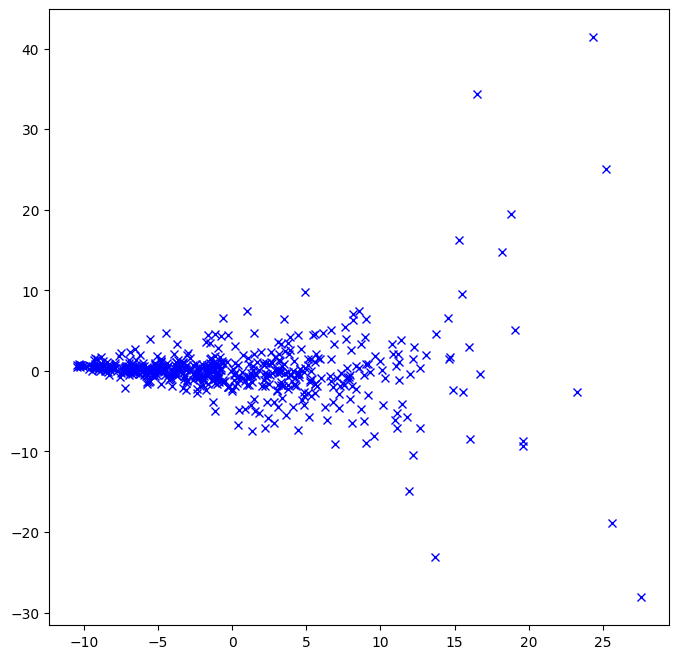

In [13]:
# get reduced dimensions
pca = PCA(n_components=2)
x_2d = pca.fit_transform(x)

# plot
plt.figure(figsize=(8, 8))
a = plt.plot(x_2d[:,0],x_2d[:,1],'bx')

In [14]:
def plot_data(X):
    plt.plot(X[:, 0], X[:, 1], 'k.', markersize=2)

def plot_centroids(centroids, weights=None, circle_color='r', cross_color='k'):
    if weights is not None:
        centroids = centroids[weights > weights.max() / 10]
    plt.scatter(centroids[:, 0], centroids[:, 1],
                marker='o', s=35, linewidths=8,
                color=circle_color, zorder=10, alpha=0.9)
    plt.scatter(centroids[:, 0], centroids[:, 1],
                marker='x', s=2, linewidths=12,
                color=cross_color, zorder=11, alpha=1)

def plot_clusters(clusterer, X):
    labels = clusterer.predict(X)
    pca = PCA(n_components=2)
    x_2d = pca.fit_transform(X)
    plt.scatter(x_2d[:, 0], x_2d[:, 1], c=labels, alpha=0.3)
    plot_centroids(clusterer.cluster_centers_)

### Finding k-number - method 1: elbow plot

/Users/irenex/anaconda3/envs/stem/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/irenex/anaconda3/envs/stem/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/irenex/anaconda3/envs/stem/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Users/irenex/anaconda3/envs/stem/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The defa

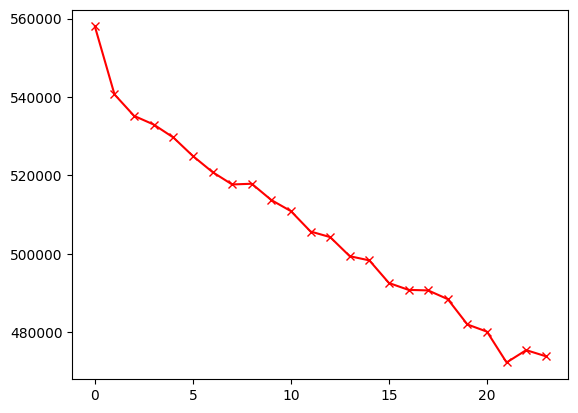

In [ ]:
# elbow plot - is there a clear elbow?? 13?
scores=[]
for i in range(1,25):
    # fit for k
    means=KMeans(n_clusters=i)
    means.fit(x)
    # get inertia
    scores.append(means.inertia_)
plt.plot(scores,'-rx')

### Finding k-number - method 2: silhouette analysis

The silhouette coefficient -  measures how close a point in one cluster is to points in the neighboring clusters,ranges from -1 to 1.
- [reference 1](https://medium.com/geekculture/stop-using-the-elbow-method-96bcfbbbe9fd)
- [reference 2](https://medium.com/@Suraj_Yadav/silhouette-coefficient-explained-with-a-practical-example-assessing-cluster-fit-c0bb3fdef719#:~:text=The%20coefficient%20ranges%20from%20%2D1,indicates%20a%20misclassified%20data%20point)
-  a value close to 1 indicates a well-clustered data point
-  a value close to 0 suggests overlapping clusters
-   a value close to -1 indicates a misclassified data point

In [83]:
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
import matplotlib.cm as cm

/Users/irenex/anaconda3/envs/stem/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


For n_clusters = 4 The average silhouette_score is : 0.112037756


/Users/irenex/anaconda3/envs/stem/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


For n_clusters = 5 The average silhouette_score is : -0.0044220006


/Users/irenex/anaconda3/envs/stem/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


For n_clusters = 6 The average silhouette_score is : -0.020414058


/Users/irenex/anaconda3/envs/stem/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


For n_clusters = 7 The average silhouette_score is : 0.109245025


/Users/irenex/anaconda3/envs/stem/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


For n_clusters = 8 The average silhouette_score is : -0.04751663


/Users/irenex/anaconda3/envs/stem/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


For n_clusters = 9 The average silhouette_score is : 0.10475047


/Users/irenex/anaconda3/envs/stem/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


For n_clusters = 10 The average silhouette_score is : -0.04314394


/Users/irenex/anaconda3/envs/stem/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


For n_clusters = 13 The average silhouette_score is : 0.07959049


/Users/irenex/anaconda3/envs/stem/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


For n_clusters = 15 The average silhouette_score is : 0.062144037


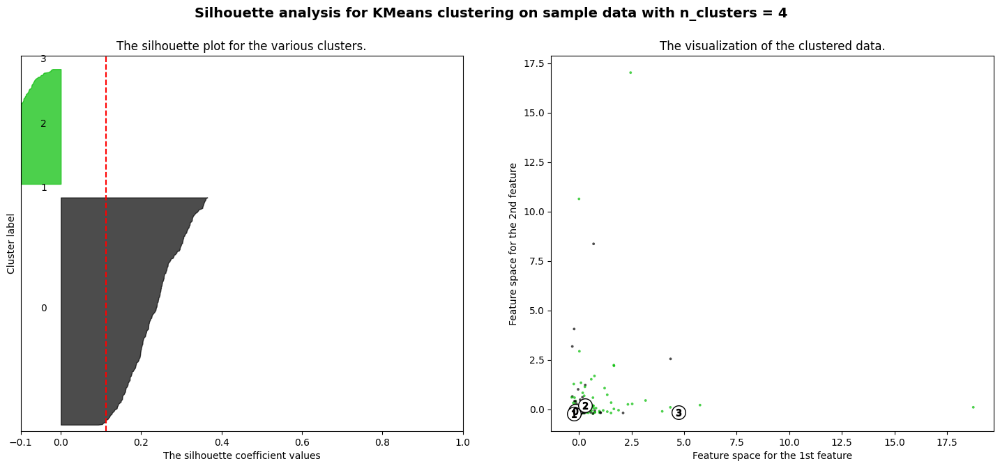

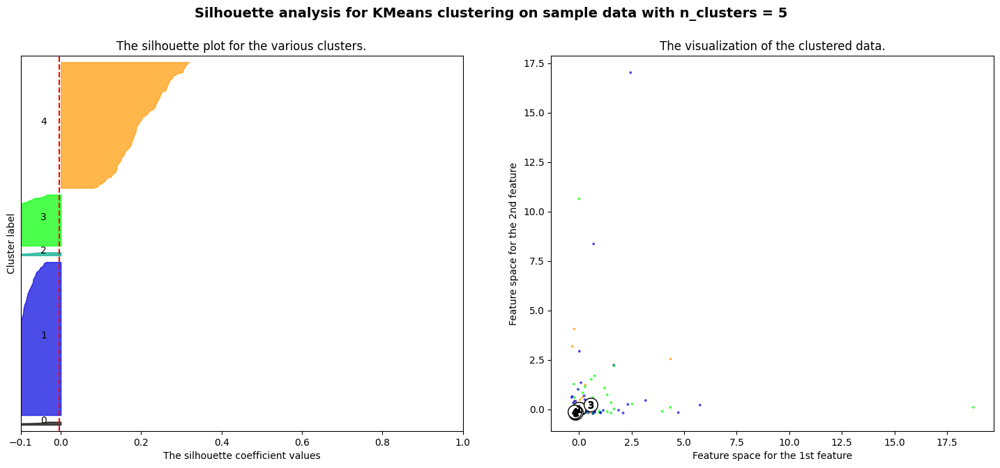

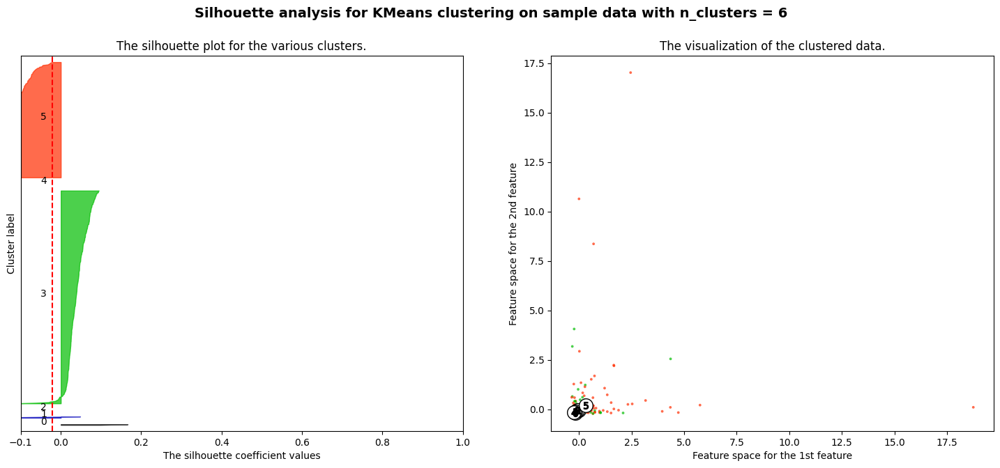

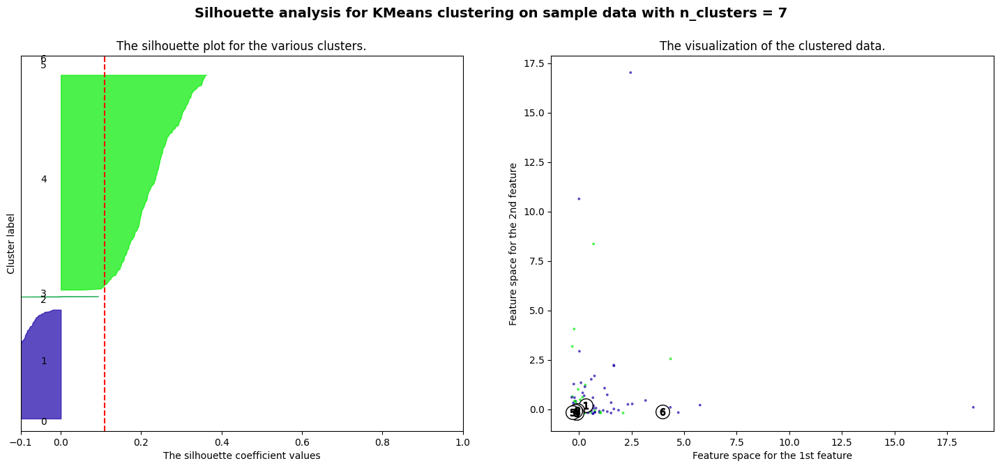

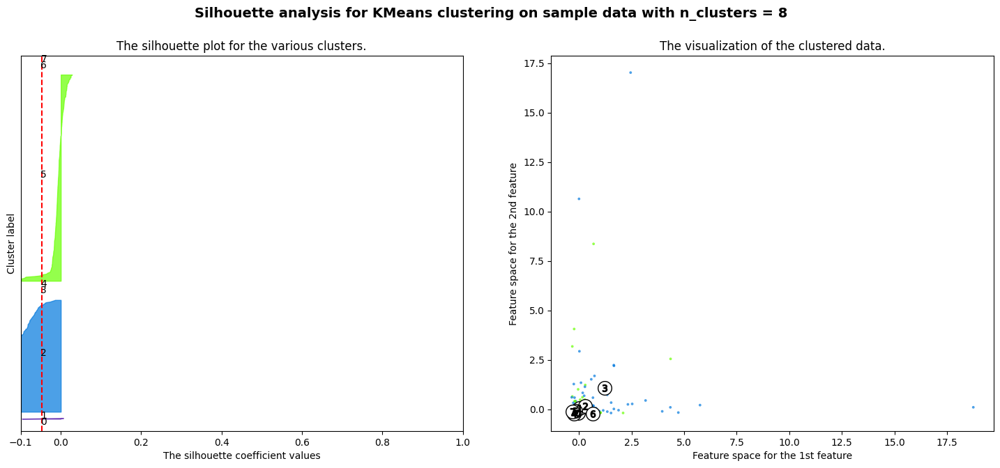

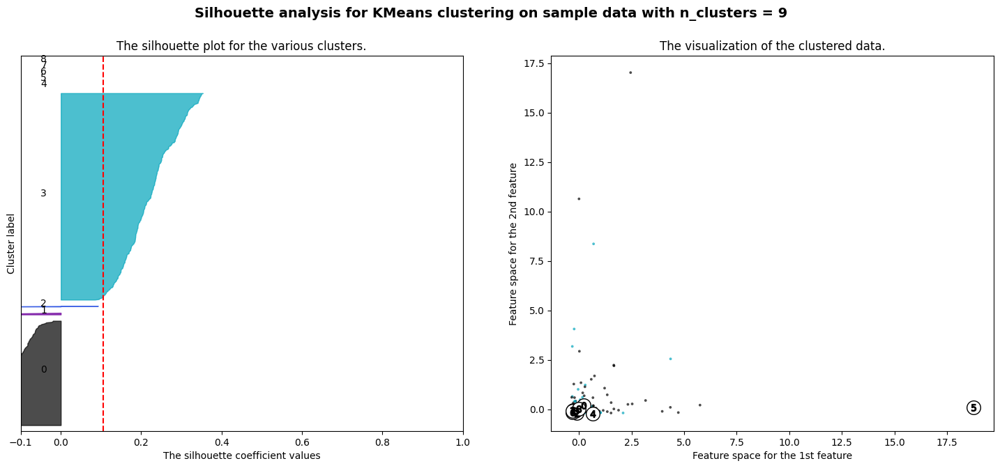

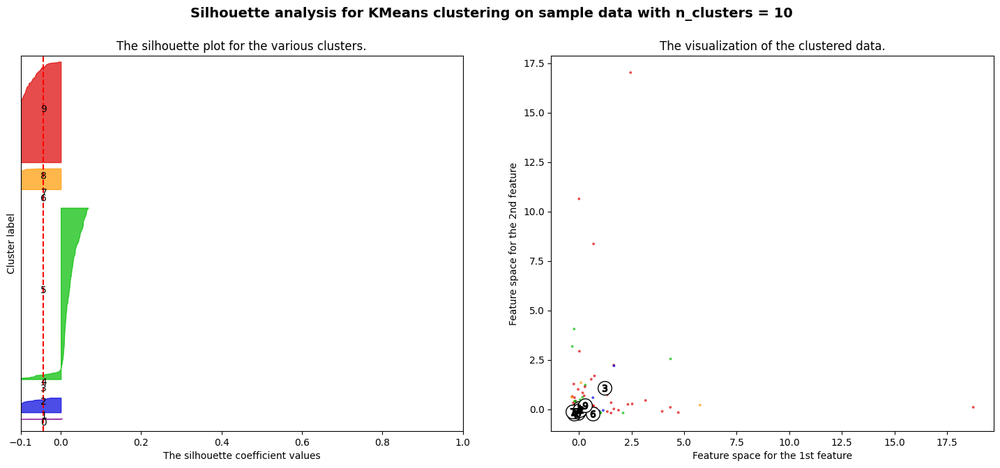

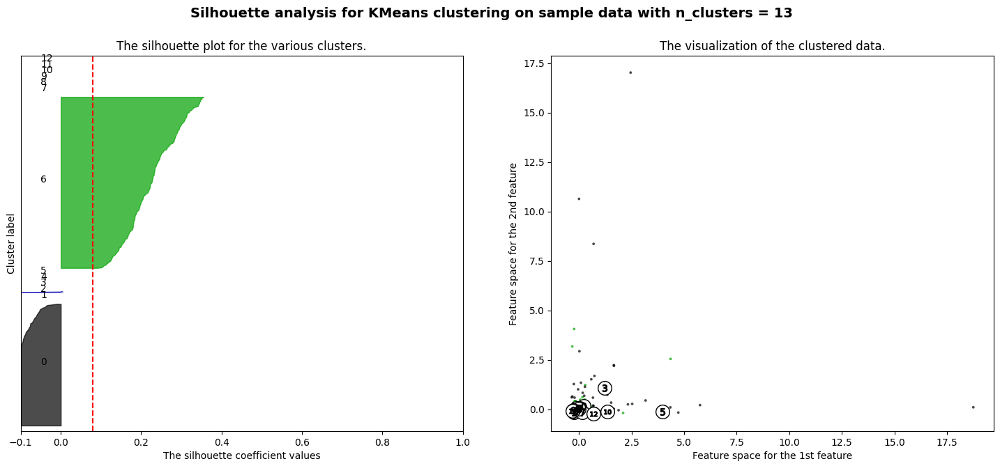

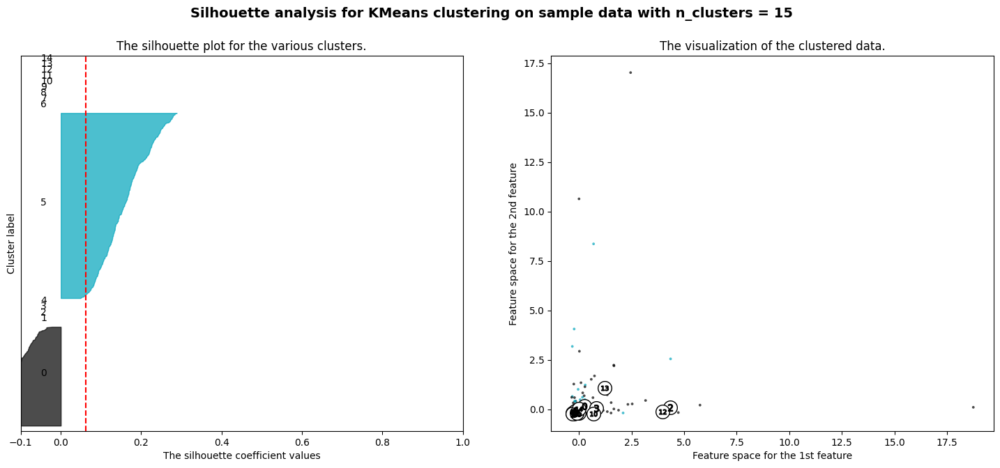

In [85]:
# silhouette analysis
# code adpated from: https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html
range_n_clusters = [4, 5, 6, 7, 8, 9, 10, 13, 15]

for n_clusters in range_n_clusters:
    # create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(x) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(x)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(x, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(x, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        x[:, 0], x[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(
        "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )

plt.show()

### clustering and plotting

/Users/irenex/anaconda3/envs/stem/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


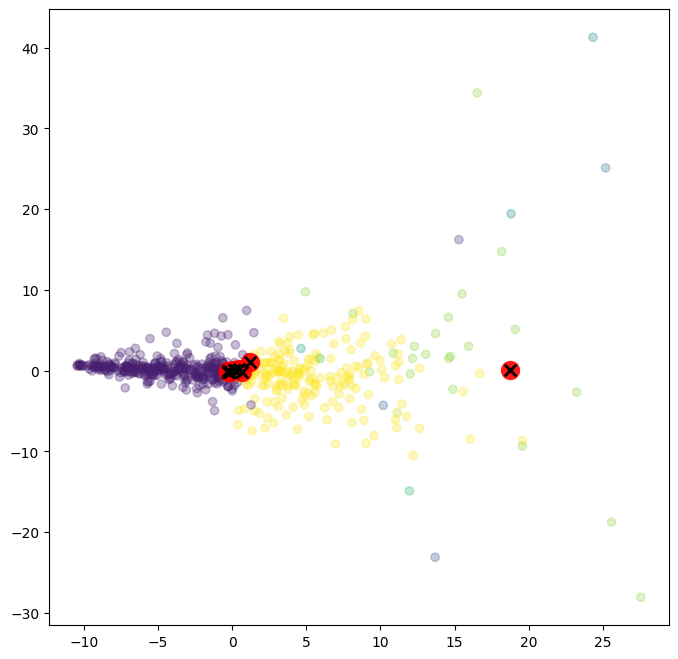

In [16]:
k = 13
kmeans = KMeans(n_clusters=k, random_state=42)
kmeans.fit(x)
plt.figure(figsize=(8, 8))

# plot clusters onto PCA reduced plot
plot_clusters(kmeans, x)

### Reduce dimensions before clustering

/Users/irenex/anaconda3/envs/stem/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


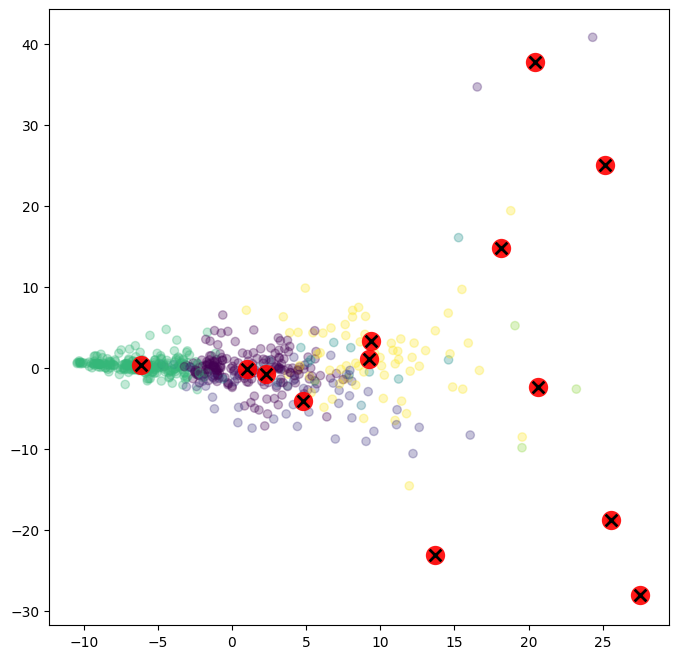

In [65]:
# how many dimensions to reduce to (before clustering)?
num_dimensions = 20

# reduce dimensions
pca = PCA(n_components=num_dimensions)
x_less_dimensions = pca.fit_transform(x)

# fit cluster
kmeans = KMeans(n_clusters=k, random_state=42)
kmeans.fit(x_less_dimensions)

# plot results
plt.figure(figsize=(8, 8))
plot_clusters(kmeans, x_less_dimensions)

### Examine Clusters

In [66]:
# define this custom function to display images in grid
from PIL import Image
from PIL import ImageDraw 
from PIL import ImageFont
font = ImageFont.truetype("../data/Arial.ttf", 24)

# define custom function to display images
def image_grid(imgs, rows, cols, labels = False):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size
    draw = ImageDraw.Draw(grid)
    for i, img in enumerate(imgs):
        r = i//cols
        c = i%cols
        pt = (c*w, r*h)
        color = (255,255,255)
        grid.paste(img, box=pt)
        if labels:
            label = "Cluster "+str(r) 
            draw.text(pt,label,color,font=font)
    return grid

In [67]:
# set num of clusters
k = 13

In [68]:
# get image closest to the centre for each cluster
kmeans = KMeans(n_clusters=k, random_state=42)
# dist to each cluster center for each image
x_dist = kmeans.fit_transform(x_less_dimensions)

/Users/irenex/anaconda3/envs/stem/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


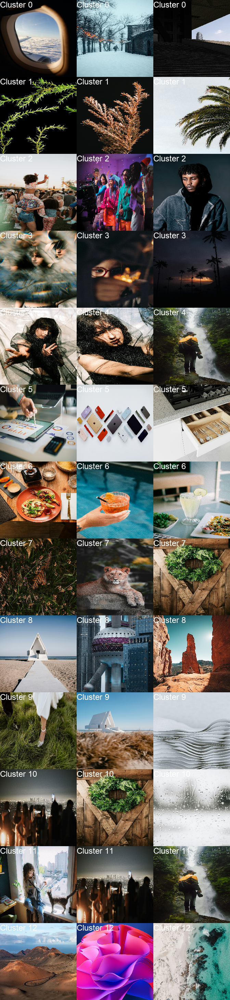

<Figure size 1000x1000 with 0 Axes>

In [69]:
cols = 3
indexes = np.array([]).astype(int)
for i in range(k):
    # get distances for a given cluster (for all images)
    cluster_dist = x_dist[:,i]
    # sort ascending (shortest distance first) and take nearest 3
    cluster_indexes = cluster_dist.argsort(axis = 0)[:cols]
    indexes = np.concatenate((indexes,cluster_indexes))
    
to_show = dataset[indexes]
to_show = [array_to_img(i) for i in to_show]
plt.figure(figsize=(10,10))

image_grid(to_show, k, cols, True)

Images Nearest the Centre of Cluster 0


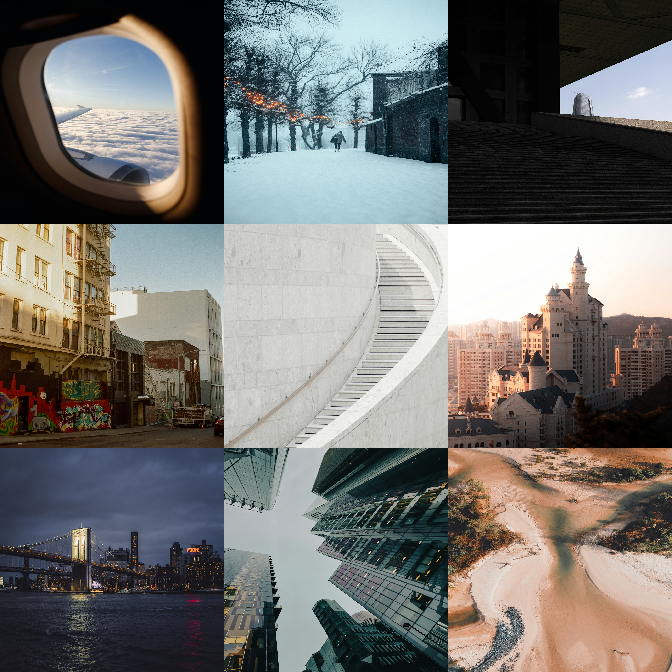

<Figure size 1000x1000 with 0 Axes>

In [70]:
# look at specifc cluster
cluster = 0
# num of images you want to see
num_to_show = 9

cluster_dist = x_dist[:,cluster]
# sort ascending (shortest distance first)
representative_indexes = cluster_dist.argsort(axis = 0)
representative_ims = dataset[representative_indexes]
to_show = representative_ims[:num_to_show]
to_show = [array_to_img(i) for i in to_show]
plt.figure(figsize=(10,10))

# how to display images (rows x cols should equal num_images!)
print("Images Nearest the Centre of Cluster " + str(cluster)) 
image_grid(to_show, 3, 3)

Images Nearest the Centre of Cluster 1


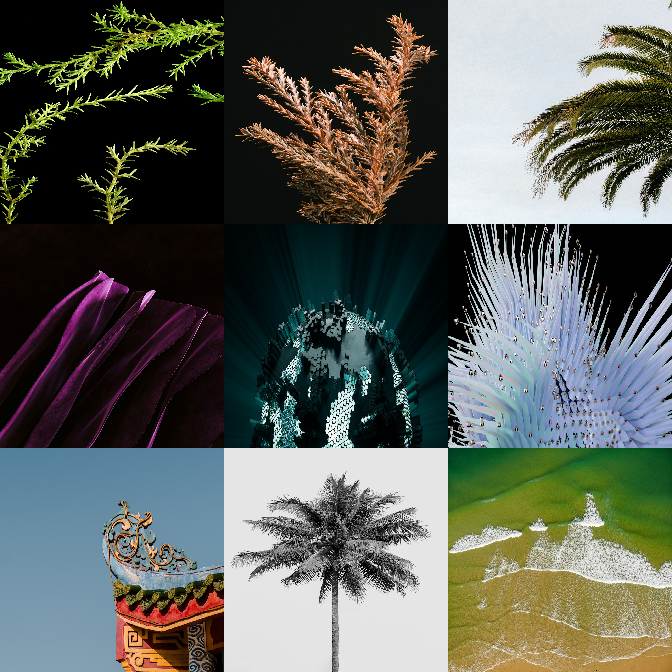

<Figure size 1000x1000 with 0 Axes>

In [71]:
# look at specifc cluster
cluster = 1
# num of images you want to see
num_to_show = 9

cluster_dist = x_dist[:,cluster]
# sort ascending (shortest distance first)
representative_indexes = cluster_dist.argsort(axis = 0)
representative_ims = dataset[representative_indexes]
to_show = representative_ims[:num_to_show]
to_show = [array_to_img(i) for i in to_show]
plt.figure(figsize=(10,10))

# how to display images (rows x cols should equal num_images!)
print("Images Nearest the Centre of Cluster " + str(cluster)) 
image_grid(to_show, 3, 3)

Images Nearest the Centre of Cluster 2


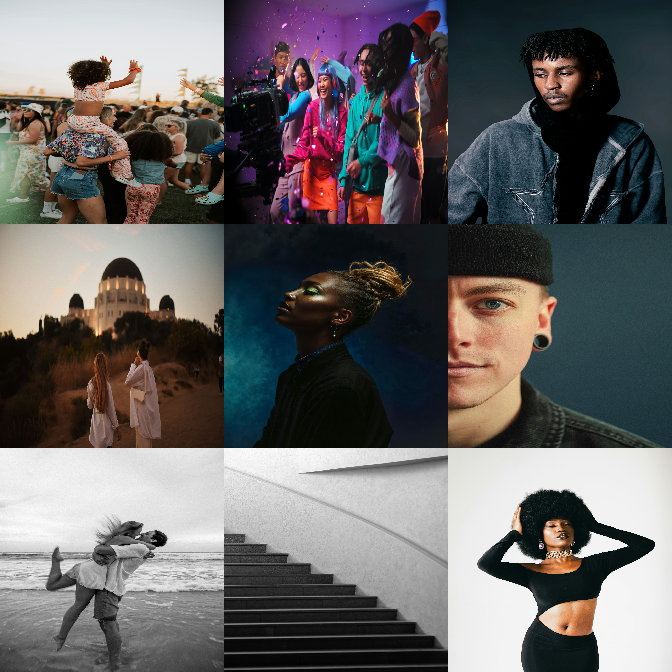

<Figure size 1000x1000 with 0 Axes>

In [72]:
# look at specifc cluster
cluster = 2
# num of images you want to see
num_to_show = 9

cluster_dist = x_dist[:,cluster]
# sort ascending (shortest distance first)
representative_indexes = cluster_dist.argsort(axis = 0)
representative_ims = dataset[representative_indexes]
to_show = representative_ims[:num_to_show]
to_show = [array_to_img(i) for i in to_show]
plt.figure(figsize=(10,10))

# how to display images (rows x cols should equal num_images!)
print("Images Nearest the Centre of Cluster " + str(cluster)) 
image_grid(to_show, 3, 3)

Images Nearest the Centre of Cluster 3


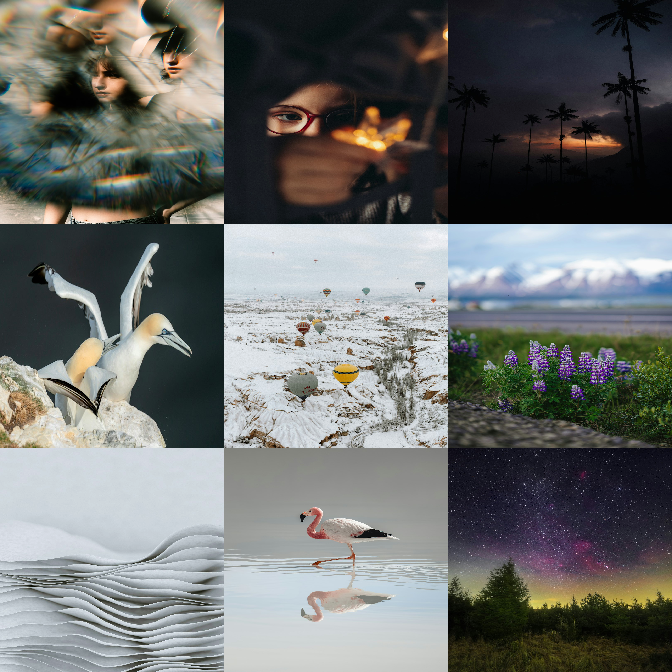

<Figure size 1000x1000 with 0 Axes>

In [73]:
# look at specifc cluster
cluster = 3
# num of images you want to see
num_to_show = 9

cluster_dist = x_dist[:,cluster]
# sort ascending (shortest distance first)
representative_indexes = cluster_dist.argsort(axis = 0)
representative_ims = dataset[representative_indexes]
to_show = representative_ims[:num_to_show]
to_show = [array_to_img(i) for i in to_show]
plt.figure(figsize=(10,10))

# how to display images (rows x cols should equal num_images!)
print("Images Nearest the Centre of Cluster " + str(cluster)) 
image_grid(to_show, 3, 3)

Images Nearest the Centre of Cluster 4


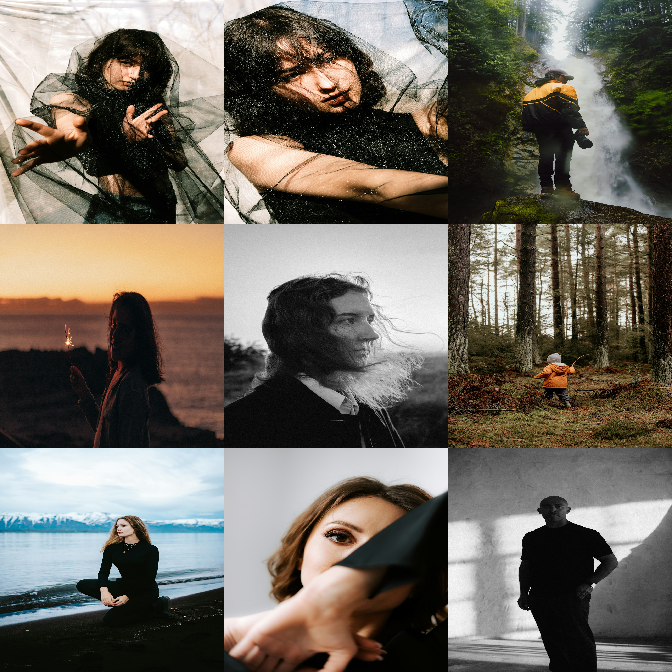

<Figure size 1000x1000 with 0 Axes>

In [74]:
# look at specifc cluster
cluster = 4
# num of images you want to see
num_to_show = 9

cluster_dist = x_dist[:,cluster]
# sort ascending (shortest distance first)
representative_indexes = cluster_dist.argsort(axis = 0)
representative_ims = dataset[representative_indexes]
to_show = representative_ims[:num_to_show]
to_show = [array_to_img(i) for i in to_show]
plt.figure(figsize=(10,10))

# how to display images (rows x cols should equal num_images!)
print("Images Nearest the Centre of Cluster " + str(cluster)) 
image_grid(to_show, 3, 3)

Images Nearest the Centre of Cluster 5


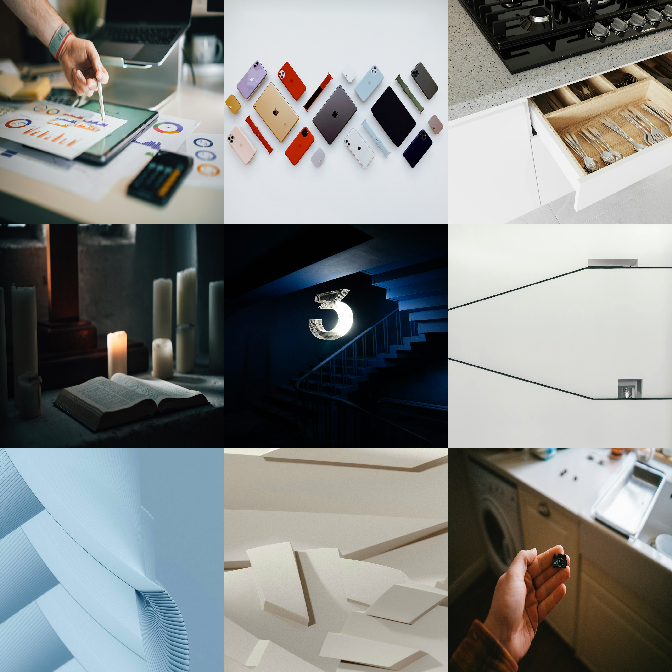

<Figure size 1000x1000 with 0 Axes>

In [75]:
# look at specifc cluster
cluster = 5
# num of images you want to see
num_to_show = 9

cluster_dist = x_dist[:,cluster]
# sort ascending (shortest distance first)
representative_indexes = cluster_dist.argsort(axis = 0)
representative_ims = dataset[representative_indexes]
to_show = representative_ims[:num_to_show]
to_show = [array_to_img(i) for i in to_show]
plt.figure(figsize=(10,10))

# how to display images (rows x cols should equal num_images!)
print("Images Nearest the Centre of Cluster " + str(cluster)) 
image_grid(to_show, 3, 3)

Images Nearest the Centre of Cluster 6


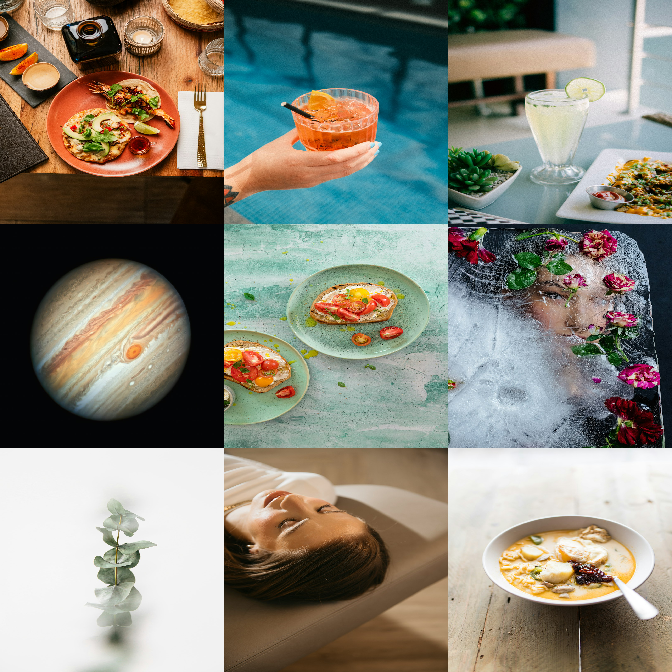

<Figure size 1000x1000 with 0 Axes>

In [76]:
# look at specifc cluster
cluster = 6
# num of images you want to see
num_to_show = 9

cluster_dist = x_dist[:,cluster]
# sort ascending (shortest distance first)
representative_indexes = cluster_dist.argsort(axis = 0)
representative_ims = dataset[representative_indexes]
to_show = representative_ims[:num_to_show]
to_show = [array_to_img(i) for i in to_show]
plt.figure(figsize=(10,10))

# how to display images (rows x cols should equal num_images!)
print("Images Nearest the Centre of Cluster " + str(cluster)) 
image_grid(to_show, 3, 3)

Images Nearest the Centre of Cluster 7


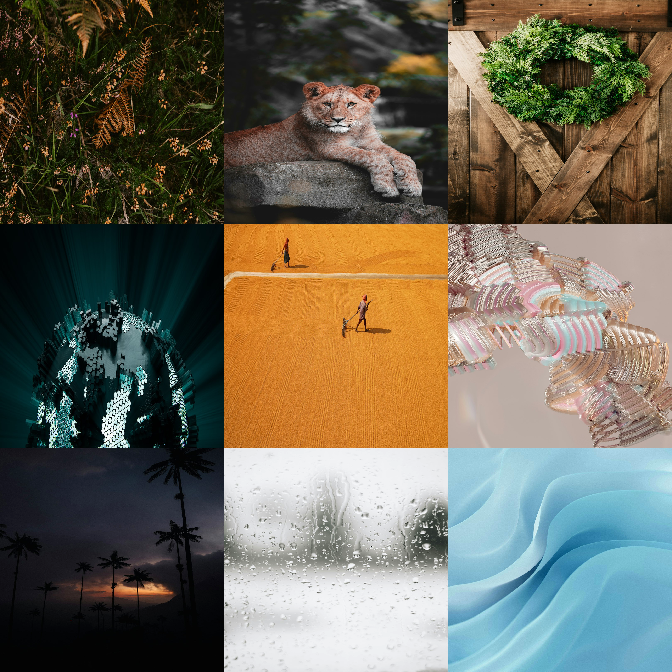

<Figure size 1000x1000 with 0 Axes>

In [77]:
# look at specifc cluster
cluster = 7
# num of images you want to see
num_to_show = 9

cluster_dist = x_dist[:,cluster]
# sort ascending (shortest distance first)
representative_indexes = cluster_dist.argsort(axis = 0)
representative_ims = dataset[representative_indexes]
to_show = representative_ims[:num_to_show]
to_show = [array_to_img(i) for i in to_show]
plt.figure(figsize=(10,10))

# how to display images (rows x cols should equal num_images!)
print("Images Nearest the Centre of Cluster " + str(cluster)) 
image_grid(to_show, 3, 3)

Images Nearest the Centre of Cluster 8


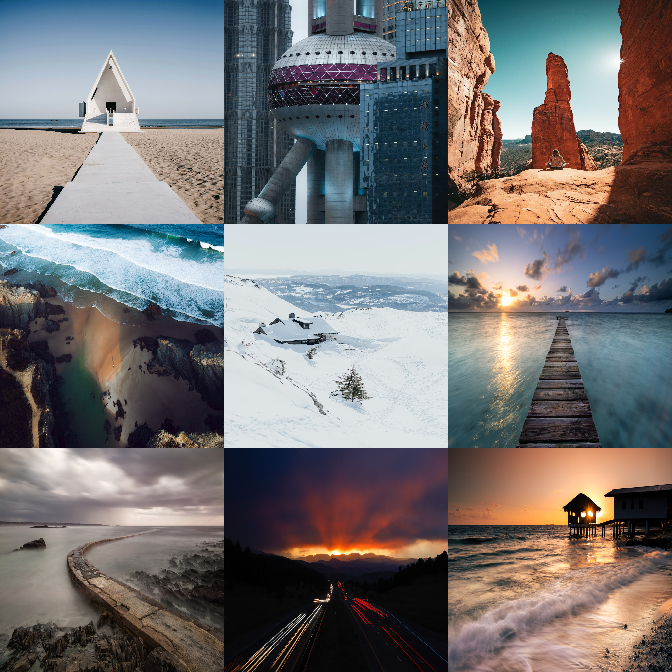

<Figure size 1000x1000 with 0 Axes>

In [78]:
# look at specifc cluster
cluster = 8
# num of images you want to see
num_to_show = 9

cluster_dist = x_dist[:,cluster]
# sort ascending (shortest distance first)
representative_indexes = cluster_dist.argsort(axis = 0)
representative_ims = dataset[representative_indexes]
to_show = representative_ims[:num_to_show]
to_show = [array_to_img(i) for i in to_show]
plt.figure(figsize=(10,10))

# how to display images (rows x cols should equal num_images!)
print("Images Nearest the Centre of Cluster " + str(cluster)) 
image_grid(to_show, 3, 3)

Images Nearest the Centre of Cluster 9


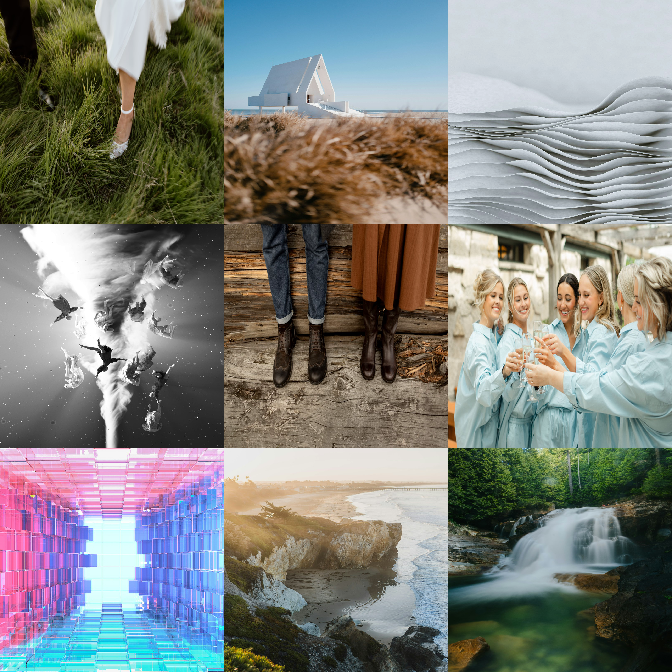

<Figure size 1000x1000 with 0 Axes>

In [79]:
# look at specifc cluster
cluster = 9
# num of images you want to see
num_to_show = 9

cluster_dist = x_dist[:,cluster]
# sort ascending (shortest distance first)
representative_indexes = cluster_dist.argsort(axis = 0)
representative_ims = dataset[representative_indexes]
to_show = representative_ims[:num_to_show]
to_show = [array_to_img(i) for i in to_show]
plt.figure(figsize=(10,10))

# how to display images (rows x cols should equal num_images!)
print("Images Nearest the Centre of Cluster " + str(cluster)) 
image_grid(to_show, 3, 3)

Images Nearest the Centre of Cluster 10


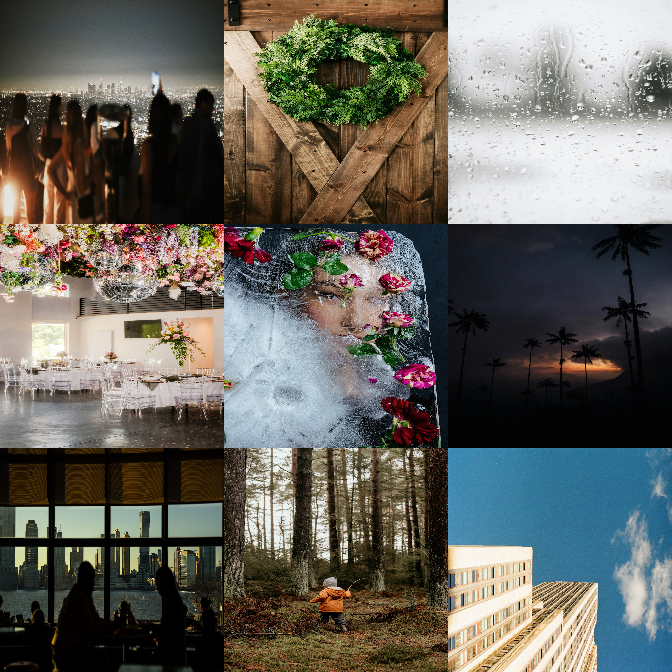

<Figure size 1000x1000 with 0 Axes>

In [80]:
# look at specifc cluster
cluster = 10
# num of images you want to see
num_to_show = 9

cluster_dist = x_dist[:,cluster]
# sort ascending (shortest distance first)
representative_indexes = cluster_dist.argsort(axis = 0)
representative_ims = dataset[representative_indexes]
to_show = representative_ims[:num_to_show]
to_show = [array_to_img(i) for i in to_show]
plt.figure(figsize=(10,10))

# how to display images (rows x cols should equal num_images!)
print("Images Nearest the Centre of Cluster " + str(cluster)) 
image_grid(to_show, 3, 3)

Images Nearest the Centre of Cluster 11


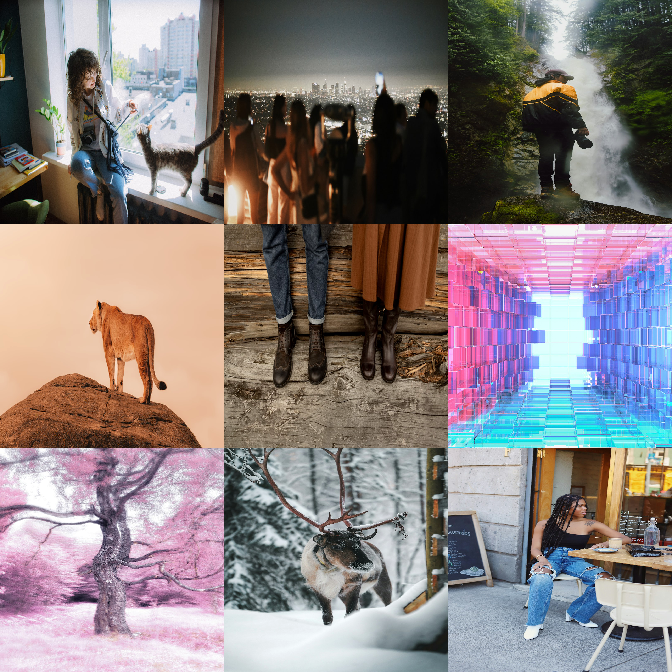

<Figure size 1000x1000 with 0 Axes>

In [81]:
# look at specifc cluster
cluster = 11
# num of images you want to see
num_to_show = 9

cluster_dist = x_dist[:,cluster]
# sort ascending (shortest distance first)
representative_indexes = cluster_dist.argsort(axis = 0)
representative_ims = dataset[representative_indexes]
to_show = representative_ims[:num_to_show]
to_show = [array_to_img(i) for i in to_show]
plt.figure(figsize=(10,10))

# how to display images (rows x cols should equal num_images!)
print("Images Nearest the Centre of Cluster " + str(cluster)) 
image_grid(to_show, 3, 3)

Images Nearest the Centre of Cluster 12


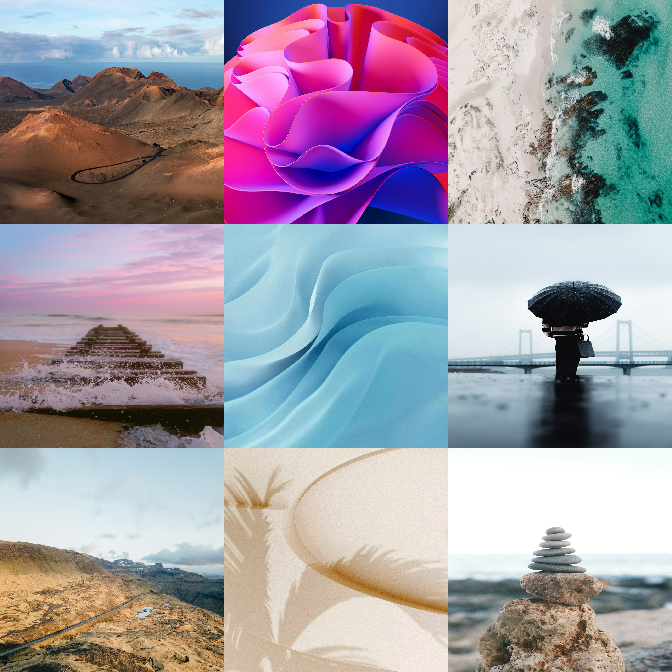

<Figure size 1000x1000 with 0 Axes>

In [82]:
# look at specifc cluster
cluster = 12
# num of images you want to see
num_to_show = 9

cluster_dist = x_dist[:,cluster]
# sort ascending (shortest distance first)
representative_indexes = cluster_dist.argsort(axis = 0)
representative_ims = dataset[representative_indexes]
to_show = representative_ims[:num_to_show]
to_show = [array_to_img(i) for i in to_show]
plt.figure(figsize=(10,10))

# how to display images (rows x cols should equal num_images!)
print("Images Nearest the Centre of Cluster " + str(cluster)) 
image_grid(to_show, 3, 3)

## Code References

[1] https://www.geeksforgeeks.org/python-pandas-dataframe-at/

[2] https://stackoverflow.com/questions/17011357/what-is-the-difference-between-content-and-text

[3] https://blog.apify.com/save-image-python/

[4] https://www.udemy.com/course/100-days-of-code/learn/lecture/22060308#overview

[5] https://stackoverflow.com/questions/51527868/how-do-i-embed-a-gif-in-jupyter-notebook

[6] https://builtin.com/data-science/elbow-method

[7] https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html

[8] https://regex101.com/

[9] https://html5up.net/

ChatGPT 3.5 has been used in this exercise for some proofreading, code debugging and for searching certain Python codes which have not been taught in class (especially for the part of silhouette analysis and javascript/HTML for the wwebpages).